<a href="https://colab.research.google.com/github/joseFranciscoDiez/HerbiSeg/blob/main/4_XVal_semantic_segment_hf_dataset_smp_models.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Cross-validation with Segmentation Models PyTorch (SMP) models.

This notebook performs cross-validation using a Hugging Face semantic segmentation dataset with various segmentation methods, including:

Models used:

- **SegFormer**
- **UPerNet**
- **FPN**
- **UNet**
- **PSPNet**




**Semantic Segmentation**: This is the task of breaking down an image into groups of pixels with similar characteristics and assigning a label to each group of pixels.

In this example, there is a background class and a herbivorous mammals trail class, but in other cases, it could involve a street photo with labels such as road, car, person, etc.

# Installations

Install TensorFlow, Hugging Face, PyTorch Lightning, and other necessary libraries.

In [1]:
from IPython.display import clear_output


In [2]:
!pip install tensorflow==2.15
clear_output()

In [3]:
!python -m pip install --upgrade --user pip
!python -m pip install --upgrade --user tensorflow_probability
clear_output()

In [4]:
!pip install accelerate -U
clear_output()

In [5]:
!pip install -q transformers evaluate
clear_output()

In [6]:
!pip install --upgrade numpy pandas
clear_output()

In [7]:
!pip install --upgrade datasets
clear_output()

Instala Segmentation Models Pytorch, Ligthing etc

In [8]:
!pip install -U git+https://github.com/qubvel-org/segmentation_models.pytorch
!pip install lightning albumentations
clear_output()

# Basic Functions

- **paths_palette()**: Returns the color palette for each class.
- **get_seg_overlay(image, segmentation)**: Creates an overlay of the original image with the segmentation prediction.

In [9]:
'''
Visualizacion

'''

from torch import nn
import numpy as np
import matplotlib.pyplot as plt






def paths_palette():
    """
    Returns the color palette for segmentation.

    This function provides a list of RGB color mappings for each class in the segmentation task.
    It assigns specific RGB values to each class, where each color is represented as a list
    containing three integers corresponding to the RGB values (Red, Green, Blue).

    Returns:
        List[List[int]]: A list of RGB colors where each sublist represents the color for a class.
                         Example: [[0, 0, 0], [216, 82, 24], [255, 255, 0]].
    """
    return [
        [0, 0, 0],       # Class 0 (e.g., background)
        [216, 82, 24],   # Class 1 (e.g., object 1)
        [255, 255, 0]    # Class 2 (e.g., object 2)
    ]


def get_seg_overlay(image, segmentation):
    """
    Creates an overlay of the segmentation map on top of the original image.

    This function takes an input image and a segmentation map and combines them to produce
    an overlay where the segmentation is shown as a semi-transparent color mask on top of
    the image. The segmentation classes are colored according to the RGB palette defined
    in the 'paths_palette' function.

    Args:
        image (np.ndarray or PIL.Image): The original input image to be displayed.
        segmentation (torch.Tensor or np.ndarray): The segmentation map (either as a torch tensor
                                                   or numpy array), where each pixel value represents
                                                   the class label.

    Returns:
        np.ndarray: An image with the segmentation map overlayed on top of the original image.
                    The result is a combination of the image and the color mask.
    """

    seg = None

    # Check if segmentation is a torch tensor (could be on CUDA), otherwise assume numpy array
    if hasattr(segmentation, 'cpu'):
        seg = segmentation.cpu()  # Move tensor to CPU if necessary
    else:
        seg = segmentation.copy()  # Copy the numpy array if not a tensor

    # Prepare the RGB color mask for the segmentation
    color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8)  # Create a blank image for the color mask
    palette = np.array(paths_palette())  # Load the color palette
    for label, color in enumerate(palette):  # For each class label, assign the corresponding color
        color_seg[seg == label, :] = color

    # Combine the original image and the segmentation mask (50% transparency each)
    img = np.array(image) * 0.5 + color_seg * 0.5  # Blend original image and segmentation mask
    img = img.astype(np.uint8)  # Ensure the result is in uint8 format (0-255 pixel range)

    return img





# Connecting to Google Drive

This version saves partial results to Google Drive, so Google Drive is mounted as a unit in Google Colab.

This is necessary because the free version of Google Colab only remains active for a few hours and is not available 100% of the time, so it is necessary to store intermediate results

In [10]:
from google.colab import drive

# Import the drive module from google.colab.
# This module allows interaction with Google Drive directly from a Colab notebook, enabling file access and storage.

# Mount Google Drive to the Colab environment at the specified path.
# Once mounted, you can read and write files directly to Google Drive using this path.
# A Google authentication prompt will appear, and once completed, the Drive will be accessible.

drive.mount('/content/drive')  # Mounts Google Drive at '/content/drive' for file access and storage.


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Download Datasets


Data loading is done with a single line using `load_dataset`.



The dataset is loaded here.



In [11]:
from datasets import load_dataset

# Load the selected dataset from the Hugging Face Hub.
# This function downloads or retrieves the dataset specified by hf_dataset_identifier.
ds = load_dataset("jfdpastor/Comp_Geo_Herb_Trails_8x")



/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/323 [00:00<?, ?B/s]

train-00000-of-00001.parquet:   0%|          | 0.00/116M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/100 [00:00<?, ? examples/s]

In [12]:
import matplotlib.pyplot as plt
import math

def show_dataset(dataset, n_cols=4):
  """
  Displays a list of images in a grid using matplotlib.

  Args:
      dataset: HuggingFace dataset.
      n_cols: The number of columns in the grid.
  """
  num_imgs = dataset["train"].num_rows
  n_rows = math.ceil(num_imgs / n_cols)
  fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, 15 * n_rows / n_cols))

  for i, element in enumerate(dataset["train"]):
    row = i // n_cols
    col = i % n_cols

    im = element['pixel_values']
    lb = element['label']

    img = get_seg_overlay(np.array(im), np.array(lb))

    if n_rows == 1 and n_cols == 1:
      axs.imshow(img)
    elif n_rows == 1:
      axs[col].imshow(img)
    else:
      axs[row, col].imshow(img)
    axs[row, col].axis('off')

  # Hide axes for subplots without images
  for i in range(num_imgs, n_rows * n_cols):
    row = i // n_cols
    col = i % n_cols
    if n_rows == 1 and n_cols == 1:
      pass
    elif n_rows == 1:
      axs[col].axis('off')
    else:
      axs[row, col].axis('off')

  plt.tight_layout()
  plt.show()



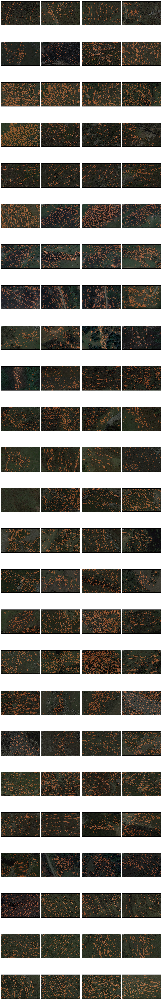

In [13]:
#show_dataset(ds)

## Conversion to a PyTorch dataset

In [14]:
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import numpy as np
import torch

'''
This class allows transforming a Semantic Segmentation Dataset from HuggingFace
into a semantic segmentation dataset compatible with PyTorch Segmentation Models.
'''
class HuggingFaceToTorchDataset(Dataset):
    def __init__(self, dataset):
        # Define image transformations
        self.transform_image = transforms.ToTensor()

        # Load images and labels from the Hugging Face dataset
        self.images = dataset["pixel_values"]
        self.labels = dataset["label"]

    def __len__(self):
        # Return the dataset size
        return len(self.images)

    def __getitem__(self, idx):
        # Retrieve image and label by index
        image = self.images[idx]
        label = self.labels[idx]

        # Apply transformations
        image_tensor = self.transform_image(image)

        # Convert label to a float tensor
        label_array = np.array(label)
        label_tensor = torch.tensor(label_array, dtype=torch.float32)

        # Normalize mask values if greater than 1 (e.g., 255 in PNG)
        if label_tensor.max() > 1:
            label_tensor = label_tensor / 255.0

        # Add a channel dimension to the label tensor
        label_tensor = label_tensor.unsqueeze(0)

        # Return a dictionary with "image" and "mask"
        return {"image": image_tensor, "mask": label_tensor}


# Functions related to cross-validation.

Starting with a dataset (a collection of image pairs: RGB and Ground Truth), multiple datasets are generated where these pairs are split into training, validation, or test sets.

With 10 folds, the data is divided into 10 different partitions, creating 10 samples of the existing images across various groups.


In [16]:
from sklearn.model_selection import KFold, train_test_split
from datasets import DatasetDict
import os
import pickle
import numpy as np
import pandas as pd

def show_splits(indexes_list):
    """
    Displays the split indexes for train, validation, and test sets.

    Parameters:
    indexes_list (list of tuples): A list of tuples where each tuple contains arrays
                                   for training, validation, and test indexes.

    Returns:
    pd.DataFrame: A DataFrame displaying the indexes for train, validation, and test splits.
    """
    train = []
    val = []
    test = []

    # Populate lists with indexes for each split
    for tr, va, te in indexes_list:
        train.append(tr)
        val.append(va)
        test.append(te)

    # Create a DataFrame to show the splits
    return pd.DataFrame({"train": train, "val": val, "test": test})

def are_disjoint(arr1, arr2, arr3):
    """
    Check if three numpy arrays are disjoint (no common elements between any pair of arrays).

    Parameters:
    arr1, arr2, arr3 (numpy.ndarray): Input arrays to be checked for disjoint property.

    Returns:
    bool: True if the arrays are disjoint, False otherwise.
    """
    # Check intersections between each pair of arrays
    if len(np.intersect1d(arr1, arr2)) > 0 or len(np.intersect1d(arr1, arr3)) > 0 or len(np.intersect1d(arr2, arr3)) > 0:
        return False
    return True



def train_val_split_indexes(n_rows, n_folds, val_size, seed):
    """
    Generates train, validation, and test indexes for cross-validation.

    Parameters:
    n_rows (int): The total number of data points.
    n_folds (int): The number of folds for cross-validation.
    val_size (float): Proportion of validation data within each split.
    seed (int): Random seed for reproducibility.

    Returns:
    list of tuples: A list of tuples where each tuple contains arrays of indexes for
                    training, validation, and test sets.
    """
    # Set random seed and create shuffled indexes
    np.random.seed(seed)
    indexes = np.arange(n_rows)
    np.random.shuffle(indexes)
    indexes_list = []

    # Calculate absolute validation set size
    val_size_absolute = int(n_rows * val_size)

    # Configure KFold splitting strategy
    kf = KFold(n_splits=n_folds, shuffle=False)

    # Generate train, validation, and test indexes for each fold
    for train_index, test_index in kf.split(indexes):
        # Validation indexes are derived from a subset of the training indexes
        val_indexes = test_index - val_size_absolute
        if val_indexes.min() < 0:
            val_indexes += n_rows

        if not seed == 0:
          #print(indexes)
          train_index = indexes[train_index]
          test_index = indexes[test_index]
          val_indexes = indexes[val_indexes]



        # Training indexes are the remaining indexes after excluding validation
        train_indexes = np.setdiff1d(train_index, val_indexes)
        #print(are_disjoint(train_indexes,val_indexes,test_index))

        # Append the split indexes to the list
        indexes_list.append((train_indexes, val_indexes, test_index))

    return indexes_list

def get_dataset_dict(ds, train_indexes, val_indexes, test_indexes):
    """
    Creates a DatasetDict for train, validation, and test datasets from indexes.

    Parameters:
    ds (Dataset): The original dataset from which samples are selected.
    train_indexes (array): Indexes for the training set.
    val_indexes (array): Indexes for the validation set.
    test_indexes (array): Indexes for the test set.

    Returns:
    DatasetDict: A dictionary with keys 'train', 'validation', and 'test', containing
                 the respective splits of the original dataset.
    """
    return DatasetDict({
        "train": ds["train"].select(train_indexes),
        "validation": ds["train"].select(val_indexes),
        "test": ds["train"].select(test_indexes)
    })

def get_train_val_split_indexes(n_rows, n_folds, val_size, seed,path="",name=""):
    """
    Retrieves or creates cross-validation indexes. If the indexes are saved on disk, they are loaded.
    Otherwise, they are generated and saved to ensure experiment consistency.

    Parameters:
    n_rows (int): The total number of data points.
    n_folds (int): The number of folds for cross-validation.
    val_size (float): Proportion of validation data within each split.
    seed (int): Random seed for reproducibility.

    Returns:
    list of tuples: A list of tuples where each tuple contains arrays of indexes for
                    training, validation, and test sets.
    """
    # Define the file name and path based on parameters
    if name == "":
      name = f"Splits_instances_{n_rows}_folds_{n_folds}_val_{val_size}_seed_{seed}.obj"
    if path =="":
      path = "./drive/MyDrive/Herbivoros/" # Default folder for herbivorous mammals trails results
    exists = os.path.exists(path + name)

    # Check if the split file exists on disk
    if not exists:
        # Generate new split indexes and save them
        indexes_list = train_val_split_indexes(n_rows, n_folds, val_size, seed)
        with open(path + name, "wb") as f:
            pickle.dump(indexes_list, f)
        return indexes_list
    else:
        # Load split indexes from disk
        print("Loading saved splits")
        with open(path + name, "rb") as f:
            indexes_list = pickle.load(f)
        return indexes_list

# Example usage
pd.set_option('display.max_colwidth', None)
display(show_splits(train_val_split_indexes(20, 10, 0.1, 0)))

,train,val,test
0,"[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]","[18, 19]","[0, 1]"
1,"[4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]","[0, 1]","[2, 3]"
2,"[0, 1, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]","[2, 3]","[4, 5]"
3,"[0, 1, 2, 3, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]","[4, 5]","[6, 7]"
4,"[0, 1, 2, 3, 4, 5, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]","[6, 7]","[8, 9]"
5,"[0, 1, 2, 3, 4, 5, 6, 7, 12, 13, 14, 15, 16, 17, 18, 19]","[8, 9]","[10, 11]"
6,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 15, 16, 17, 18, 19]","[10, 11]","[12, 13]"
7,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 16, 17, 18, 19]","[12, 13]","[14, 15]"
8,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 18, 19]","[14, 15]","[16, 17]"
9,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]","[16, 17]","[18, 19]"


# Auxiliary functions needed evaluating models.

In [17]:
import numpy as np


def my_ravel_recursive(array):
  '''
  Flattens a nested array structure recursively.

  Args:
      array (np.ndarray): Input array which may contain nested sub-arrays.

  Returns:
      np.ndarray: A flattened version of the input array where all nested arrays are concatenated.
  '''
  # Base case: if the first element is not an ndarray, return the array as it is already flattened
  if not isinstance(array[0], np.ndarray):
    return array
  else:
    # Recursively flatten each nested array and concatenate the results
    return np.concatenate([my_ravel_recursive(array[i]) for i in range(len(array))])


In [18]:
def get_F1_IoU_irregular(labels,pred_labels):
  '''
  Calculates evaluation metrics (IoU, F1, Precision, Recall) for irregularly sized images.

  Args:
      labels (np.ndarray): Ground truth labels.
      pred_labels (np.ndarray): Predicted labels from the model.

  Returns:
      dict: Dictionary containing IoU, F1, Precision, Recall, TP, TN, FP, FN metrics.
  '''


  labels1d = my_ravel_recursive(labels).astype(bool)
  pred_labels1d = my_ravel_recursive(pred_labels).astype(bool)

  # Calculate True Positives, True Negatives, False Positives, and False Negatives
  tp = np.sum(labels1d & pred_labels1d)
  tn =np.sum((~labels1d) & (~pred_labels1d))
  fp =np.sum((~labels1d) & pred_labels1d)
  fn =np.sum( labels1d & (~pred_labels1d))
  #print(tp, tn, fp, fn)
  #print(tp+tn+fp+fn-labels1d.size)

  # Calculate Precision and Recall, handling division by zero
  precision = tp / (tp + fp) if (tp + fp) > 0 else 0
  recall = tp / (tp + fn) if (tp + fn) > 0 else 0

  # Calculate F1 score
  f1 = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

  # Calculate Intersection over Union (IoU)
  iou = tp / (tp + fn + fp) if (tp + fn + fp) > 0 else 0

  return {'IoU Path': iou, 'F1_Path': f1,
          "Precision": precision, "Recall": recall,
          "TP":tp, "TN":tn, "FP":fp, "FN":fn
          }


def evalua_preds_multiple(preds):
  '''
  Evaluates predictions for multiple images and returns metrics for each image as a DataFrame.

  Args:
      preds (list): List of tuples (ground truth, prediction, image) for evaluation.

  Returns:
      pd.DataFrame: DataFrame with IoU, F1, Precision, Recall, TP, TN, FP, FN for each image.
  '''

  iou, f1, prec, rec = [], [], [], []
  tp,tn,fp,fn = [], [], [], []
  folds_ids, images_ids = [],[]
  for i,(gt_seg,pred_seg,image,fold_id,img_id) in enumerate(preds):

    metrics = get_F1_IoU_irregular(np.array(gt_seg),pred_seg)
    iou.append(metrics['IoU Path'])
    f1.append(metrics['F1_Path'])
    prec.append(metrics['Precision'])
    rec.append(metrics['Recall'])
    tp.append(metrics['TP'])
    tn.append(metrics['TN'])
    fp.append(metrics['FP'])
    fn.append(metrics['FN'])
    folds_ids.append(fold_id)
    images_ids.append(img_id)

  return pd.DataFrame({"IoU":iou,"F1":f1,"Precision":prec,"Recall":rec,
                       "TP":tp, "TN":tn, "FP":fp, "FN":fn,
                       "Fold":folds_ids,"Img_id":images_ids})



def draw_preds_multiple(preds,prefix,method,compute_metrics = False):
  '''
  Generates and saves plots of model predictions vs. ground truth with optional metrics overlay.

  Args:
      preds (list): List of tuples (ground truth, prediction, image) for display.
      prefix (str): Prefix for saved file names.
      method (str): Method name to include in file names.
      compute_metrics (bool): If True, compute and display metrics on each plot.
  '''

  for i,(gt_seg,pred_seg,image) in enumerate(preds):
    pred_img = get_seg_overlay(image, pred_seg)
    gt_img = get_seg_overlay(image, np.array(gt_seg))


    print(i)
    # Optional: compute metrics and display them as title overlay
    extra = " "
    if compute_metrics:
      metrics = get_F1_IoU_irregular(np.array(gt_seg),pred_seg)
      extra = f"IoU: {metrics['IoU Path']:.2f}, F1: {metrics['F1_Path']:.2f}, " \
                    f"Precision: {metrics['Precision']:.2f}, Recall: {metrics['Recall']:.2f}"

    # Plot predicted segmentation
    f, axs = plt.subplots(1, 1)
    f.set_figheight(30)
    f.set_figwidth(30)
    axs.set_title(f"{extra}", {'fontsize': 72}) # cambiado desde 48
    axs.imshow(pred_img)
    plt.tight_layout()
    plt.savefig(f'{prefix}_{method}_{i}.png',bbox_inches='tight')
    plt.close()

    # Plot ground truth segmentation
    f, axs = plt.subplots(1, 1)
    f.set_figheight(30)
    f.set_figwidth(30)
    axs.set_title("Ground truth", {'fontsize': 72, 'color':'white'})
    axs.imshow(gt_img)
    plt.tight_layout()
    plt.savefig(f'{prefix}_GT_{i}.png',bbox_inches='tight')
    plt.close()

    # Plot ground original
    f, axs = plt.subplots(1, 1)
    f.set_figheight(30)
    f.set_figwidth(30)
    axs.set_title("Original", {'fontsize': 72, 'color':'white'})
    axs.imshow(image)
    plt.tight_layout()
    plt.savefig(f'{prefix}_pix_{i}.png',bbox_inches='tight')
    plt.close()


def draw_all_preds(all_preds,names,prefix,compute_metrics = False):
  '''
  Generates plots comparing predictions from multiple algorithms against the ground truth.

  Args:
      all_preds (list): List of predictions from different algorithms, each containing tuples of (ground truth, prediction, image).
      names (list): List of algorithm names.
      prefix (str): Prefix for saved file names.
      compute_metrics (bool): If True, compute and display metrics on each plot.
  '''


  for i,pred_tuple in enumerate(zip(*all_preds)):

    print(i)

    gt_seg = pred_tuple[0][0]
    image = pred_tuple[0][2]
    # Extract predictions for each algorithm
    pred_seg1 = pred_tuple[0][1]
    pred_seg2 = pred_tuple[1][1]
    pred_seg3 = pred_tuple[2][1]

    gt_img = get_seg_overlay(image, np.array(gt_seg))
    pred_img1 = get_seg_overlay(image, pred_seg1)
    pred_img2 = get_seg_overlay(image, pred_seg2)
    pred_img3 = get_seg_overlay(image, pred_seg3)

    f, axs = plt.subplots(2, 2)
    f.set_figheight(50)
    f.set_figwidth(90)

    # Optional: compute metrics and display them as title overlay for each algorithm
    extra1, extra2, extra3 = " "," "," "
    if compute_metrics:
      metrics = get_F1_IoU_irregular(np.array(gt_seg),pred_seg1)
      extra1 = f"{names[0]} IoU Path: {metrics['IoU Path']:.2f}, 'F1 Path': {metrics['F1_Path']:.2f}"

      metrics = get_F1_IoU_irregular(np.array(gt_seg),pred_seg2)
      extra2 = f"{names[1]} IoU Path: {metrics['IoU Path']:.2f}, 'F1 Path': {metrics['F1_Path']:.2f}"

      metrics = get_F1_IoU_irregular(np.array(gt_seg),pred_seg3)
      extra3 = f"{names[2]} IoU Path: {metrics['IoU Path']:.2f}, 'F1 Path': {metrics['F1_Path']:.2f}"

    # Display ground truth and predictions with metrics as titles
    axs[0,0].set_title("Ground truth", {'fontsize': 40})
    axs[0,0].imshow(gt_img)
    axs[0,1].set_title(f"Prediction {extra1}", {'fontsize': 40})
    axs[0,1].imshow(pred_img1)

    axs[1,0].set_title(f"Prediction {extra2}", {'fontsize': 40})
    axs[1,0].imshow(pred_img2)

    axs[1,1].set_title(f"Prediction {extra3}", {'fontsize': 40})
    axs[1,1].imshow(pred_img3)

    plt.tight_layout()
    plt.savefig(f'{prefix}_{i}.png')






# Retrieving Predictions from Google Drive

In [20]:
import os
import pickle
def load_preds(data_name,dataset,method,lr,epochs,n_folds,val_size,seed,path="",name=""):
  """
  Loads predictions from local storage and retrieves ground truth and pixel values from the dataset.

  Args:
      data_name (str): Identifier for the dataset.
      dataset: HuggingFace dataset object.
      method (str): The method used for model training.
      lr (float): Learning rate for model training.
      epochs (int): Number of training epochs.
      n_folds (int): Number of folds used in cross-validation.
      val_size (float): Validation set size as a proportion of the dataset.
      seed (int): Random seed for reproducibility in data splitting.

  Returns: XXX cambia, ahora se devuelve fold num también
      list of tuples: Each tuple contains ground truth labels, predictions, and pixel values from the test set.
  """
  # Define the file path where predictions are stored
  if path == "":
    path = "./drive/MyDrive/Herbivoros/"

  # Get the number of rows in the training set and the index splits for cross-validation
  n_rows = dataset["train"].num_rows
  print("n_rows",n_rows)
  indexes_list = get_train_val_split_indexes(n_rows,n_folds,val_size,seed,path,name)

  # Initialize lists to collect predictions, ground truth labels, and pixel values
  all_preds = []
  all_gts = []
  all_pixel_vals = []
  fold_num = []
  img_id = []

  # Iterate over each fold to retrieve predictions and corresponding data
  for fold in range(n_folds):
    filename = f"data.{data_name}_method.{method}_lr.{lr}_epochs.{epochs}_fold.{fold}.preds"
    exists = os.path.exists(path+filename)
    print(filename,exists)

    # If prediction file exists, load it
    if exists:
      with open(f"{path}{filename}", "rb") as f:
        preds = pickle.load(f)
        all_preds+=preds
        fold_num+=[fold]*len(preds)

      # Retrieve ground truth and pixel values for the test set in the current fold
      tr,va,te = indexes_list[fold]

      img_id+=list(te)
      data_dict = get_dataset_dict(dataset,tr,va,te)
      print(data_dict)
      all_gts+=data_dict["test"]["label"]
      all_pixel_vals+=data_dict["test"]["pixel_values"]



  return list(zip(all_gts,all_preds,all_pixel_vals,fold_num,img_id))





# SemanticSegmentator

These classes abstract all the complexity of SMP and provide a simple way to use the segmentation models.

In [21]:
import gc
import torch
import pytorch_lightning as pl
from torch.optim import lr_scheduler
import segmentation_models_pytorch as smp

class BinarySegModel(pl.LightningModule):
    """
    A PyTorch Lightning Module for binary segmentation tasks.

    Args:
        arch (str): Model architecture to use.
        encoder_name (str): Encoder to use for the architecture.
        loss_f (str): Loss function to use (e.g., "dice").
        in_channels (int): Number of input channels.
        out_classes (int): Number of output classes (e.g., 1 for binary segmentation).
        lr (float): Learning rate for the optimizer.
        t_max (int): Maximum number of iterations for learning rate scheduler.
        **kwargs: Additional keyword arguments for the model.
    """
    def __init__(self, arch, encoder_name, loss_f, in_channels, out_classes, lr, t_max, **kwargs):
        super().__init__()
        self.model = smp.create_model(
            arch,
            encoder_name=encoder_name,
            in_channels=in_channels,
            classes=out_classes,
            **kwargs,
        )
        # Preprocessing parameters for image normalization
        params = smp.encoders.get_preprocessing_params(encoder_name)
        self.register_buffer("std", torch.tensor(params["std"]).view(1, 3, 1, 1))
        self.register_buffer("mean", torch.tensor(params["mean"]).view(1, 3, 1, 1))


        # for image segmentation dice loss could be the best first choice
        if loss_f == "dice":
            self.loss_fn = smp.losses.DiceLoss(smp.losses.BINARY_MODE, from_logits=True)
        else:
            self.loss_fn = smp.losses.DiceLoss(smp.losses.BINARY_MODE, from_logits=True)

        # Store metrics per epoch
        self.train_metrics_per_epoch = []
        self.valid_metrics_per_epoch = []
        self.test_metrics_per_epoch = []

        # Initialize step metrics
        self.training_step_outputs = []
        self.validation_step_outputs = []
        self.test_step_outputs = []

        self.lr = lr  # Learning rate
        self.t_max = t_max  # Maximum scheduler steps

    def forward(self, image):
        """
        Forward pass for the model.

        Args:
            image (torch.Tensor): Input image tensor.

        Returns:
            torch.Tensor: Predicted mask.
        """
        # Normalize the image
        image = (image - self.mean) / self.std
        mask = self.model(image)
        return mask

    def shared_step(self, batch, stage):
        """
        Common logic for training, validation, and test steps.

        Args:
            batch (dict): Batch of data containing "image" and "mask".
            stage (str): Current stage ("train", "valid", "test").

        Returns:
            dict: Loss and metrics (tp, fp, fn, tn).
        """
        image = batch["image"]

	      # Shape of the image should be (batch_size, num_channels, height, width)
        # if you work with grayscale images, expand channels dim to have [batch_size, 1, height, width]
        assert image.ndim == 4

        # Ensure image dimensions are divisible by 32
        h, w = image.shape[2:]
        assert h % 32 == 0 and w % 32 == 0

        mask = batch["mask"]
        assert mask.ndim == 4

        # Ensure mask values are between 0 and 1
        assert mask.max() <= 1.0 and mask.min() >= 0

        logits_mask = self.forward(image)

        # Compute loss
        loss = self.loss_fn(logits_mask, mask)

        # Compute metrics
        prob_mask = logits_mask.sigmoid()
        pred_mask = (prob_mask > 0.5).float()

        tp, fp, fn, tn = smp.metrics.get_stats(pred_mask.long(), mask.long(), mode="binary")
        return {"loss": loss, "tp": tp, "fp": fp, "fn": fn, "tn": tn}

    def shared_epoch_end(self, outputs, stage):
        """
        Aggregate metrics and compute averages for the epoch.

        Args:
            outputs (list): List of outputs from each batch.
            stage (str): Current stage ("train", "valid", "test").

        Returns:
            dict: Aggregated metrics for the epoch.
        """
        tp = torch.cat([x["tp"] for x in outputs])
        fp = torch.cat([x["fp"] for x in outputs])
        fn = torch.cat([x["fn"] for x in outputs])
        tn = torch.cat([x["tn"] for x in outputs])

        loss = torch.stack([x["loss"] for x in outputs]).mean()

        per_image_iou = smp.metrics.iou_score(tp, fp, fn, tn, reduction="micro-imagewise")
        dataset_iou = smp.metrics.iou_score(tp, fp, fn, tn, reduction="micro")

        metrics = {
            f"{stage}_per_image_iou": float(per_image_iou),
            f"{stage}_dataset_iou": float(dataset_iou),
            f"{stage}_loss": float(loss),
            f"{stage}_tp": int(tp.sum()),
            f"{stage}_fp": int(fp.sum()),
            f"{stage}_fn": int(fn.sum()),
            f"{stage}_tn": int(tn.sum()),
        }

        self.log_dict(metrics, prog_bar=True)
        return metrics

    def training_step(self, batch, batch_idx):
        """
        Training step logic.

        Args:
            batch (dict): Batch of data.
            batch_idx (int): Batch index.

        Returns:
            dict: Loss and metrics for the current training step.
        """
        train_loss_info = self.shared_step(batch, "train")
        self.training_step_outputs.append(train_loss_info)
        return train_loss_info

    def on_train_epoch_end(self):
        """
        Called at the end of a training epoch to log and aggregate metrics.
        """
        metrics = self.shared_epoch_end(self.training_step_outputs, "train")
        metrics["epoch"] = self.current_epoch
        self.train_metrics_per_epoch.append(metrics)
        self.training_step_outputs.clear()

    def validation_step(self, batch, batch_idx):
        """
        Validation step logic.

        Args:
            batch (dict): Batch of data.
            batch_idx (int): Batch index.

        Returns:
            dict: Loss and metrics for the current validation step.
        """
        valid_loss_info = self.shared_step(batch, "valid")
        self.validation_step_outputs.append(valid_loss_info)
        return valid_loss_info

    def on_validation_epoch_end(self):
        """
        Called at the end of a validation epoch to log and aggregate metrics.
        """
        metrics = self.shared_epoch_end(self.validation_step_outputs, "valid")
        metrics["epoch"] = self.current_epoch
        self.valid_metrics_per_epoch.append(metrics)
        self.validation_step_outputs.clear()

    def test_step(self, batch, batch_idx):
        """
        Test step logic.

        Args:
            batch (dict): Batch of data.
            batch_idx (int): Batch index.

        Returns:
            dict: Loss and metrics for the current test step.
        """
        test_loss_info = self.shared_step(batch, "test")
        self.test_step_outputs.append(test_loss_info)
        return test_loss_info

    def on_test_epoch_end(self):
        """
        Called at the end of a test epoch to log and aggregate metrics.
        """
        metrics = self.shared_epoch_end(self.test_step_outputs, "test")
        metrics["epoch"] = self.current_epoch
        self.test_metrics_per_epoch.append(metrics)
        self.test_step_outputs.clear()

    # JF estos parámetros se podrían sacar
    # JF falta
    def configure_optimizers(self):
        # Configure the optimizer and learning rate scheduler
        optimizer = torch.optim.Adam(self.parameters(), lr=self.lr)
        scheduler = lr_scheduler.CosineAnnealingLR(optimizer, T_max=self.t_max, eta_min=1e-5)
        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": scheduler,
                "interval": "step",
                "frequency": 1,
            },
        }



class SemanticSegmentatorPyTorch:
    """
    A semantic segmentation model training and inference class using PyTorch Lightning.

    Constructor:
        Args:
            arq (str): The architecture type for the model.
            encoder (str): The encoder architecture to use.
            loss (torch.nn.Module): The loss function to be used during training.
            hub_model_id (str): The ID for saving the model to the HuggingFace Hub.
            lr (float): The learning rate for the optimizer.
            epochs (int): The number of training epochs.
    """
    def __init__(self, arq, encoder, loss, hub_model_id, lr, epochs):
        self.arq = arq
        self.encoder = encoder
        self.loss = loss
        self.hub_model_id = hub_model_id
        self.lr = lr
        self.epochs = epochs


        # Initializes a PyTorch Lightning Trainer with the specified maximum number of epochs
        self.trainer = pl.Trainer(max_epochs=epochs, log_every_n_steps=20)

    def fit(self, train_dataloader, val_dataloader):
        """
        Trains the model using the provided training and validation dataloaders.

        Args:
            train_dataloader (DataLoader): Dataloader for training data.
            val_dataloader (DataLoader): Dataloader for validation data.
        """
        print("fit")



        train_dataset_size = len(train_dataloader.dataset)
        batch_size = 2
        t_max = self.epochs * (train_dataset_size // batch_size)

        print("t_max", t_max)

        # Initializes the BinarySegModel with specified parameters
        self.model = BinarySegModel(
            self.arq, self.encoder, self.loss,
            in_channels=3, out_classes=1, lr=self.lr, t_max=t_max
        )

        # Fits the model using the trainer
        self.trainer.fit(
            self.model,
            train_dataloaders=train_dataloader,
            val_dataloaders=val_dataloader
        )

        # Validate the model on the validation dataloader
        valid_metrics = self.trainer.validate(self.model, dataloaders=val_dataloader, verbose=False)
        print(valid_metrics)

    def predict(self, test_dataloader):
        """
        Generates predictions for test data.

        Args:
            test_dataloader (DataLoader): Dataloader for test data.

        Returns:
            list: Predictions (binarized masks) for the test data.
        """
        preds = []

        # Iterate over the entire test dataloader
        with torch.no_grad():
            self.model.eval()  # Set model to evaluation mode
            for batch in test_dataloader:  # Iterate over all batches
                logits = self.model(batch["image"])
                pr_masks = logits.sigmoid()

                for pr_mask in pr_masks:
                    pr_mask = (pr_mask > 0.5).float()  # Binarize the prediction
                    preds.append(pr_mask.numpy().squeeze())

        return preds

    def clear(self):
        """
        Clears variables and releases GPU memory.
        """
        del self.model
        del self.trainer

        gc.collect()
        torch.cuda.empty_cache()

    def get_logs(self):
        """
        Retrieves the validation metrics logged per epoch.

        Returns:
            list: Validation metrics logged during training.
        """
        return self.model.valid_metrics_per_epoch


# Main method that performs the experiments

In [22]:
def perform_single_experiment_pytorch(data_name, dataset, indexes_list, method, lr, epochs, fold):
    """
    Executes a single training and testing experiment for semantic segmentation using PyTorch.

    Args:
        data_name (str): The name of the dataset being used.
        dataset (Dataset): The HuggingFace dataset containing image data and labels.
        indexes_list (list of tuples): A list of index splits for train, validation, and test sets.
        method (str): The semantic segmentation method, including architecture and encoder, separated by colon (:).
        lr (float): Learning rate for the training process.
        epochs (int): Number of epochs for training.
        fold (int): The fold index for cross-validation.

    Returns:
        None: The function saves predictions and logs to the disk.
    """

    # Retrieves the indexes for the train, validation, and test partitions for the current fold
    tr, va, te = indexes_list[fold]

    # Creates a dataset dictionary with train, validation, and test partitions
    data_dict = get_dataset_dict(dataset, tr, va, te)

    # Generates a unique experiment ID based on the parameters
    exp_id = f"data.{data_name}_method.{method}_lr.{lr}_epochs.{epochs}_fold.{fold}"

    # Splits the method string into architecture and encoder components
    arq, encoder = method.split(":")

    # Converts the HuggingFace datasets into PyTorch-compatible datasets
    train_data = HuggingFaceToTorchDataset(data_dict["train"])
    valid_data = HuggingFaceToTorchDataset(data_dict["validation"])
    test_data = HuggingFaceToTorchDataset(data_dict["test"])

    # Creates DataLoaders for train, validation, and test datasets
    # Ensures all images are processed with drop_last=False

    train_dataloader = DataLoader(train_data, batch_size=2, shuffle=False, drop_last=False)
    valid_dataloader = DataLoader(valid_data, batch_size=2, shuffle=False, drop_last=False)
    test_dataloader = DataLoader(test_data, batch_size=2, shuffle=False, drop_last=False)

    # Initializes a PyTorch-based semantic segmentation model
    ss = SemanticSegmentatorPyTorch(arq, encoder, "dice", "", lr, epochs)

    # Trains the model using the train and validation DataLoaders
    ss.fit(train_dataloader, valid_dataloader)

    # Obtains predictions for the test dataset
    preds = ss.predict(test_dataloader)

    # Saves the predictions to a file
    print(f"Saving {exp_id}.preds")
    path = "./drive/MyDrive/Herbivoros/"
    with open(f"{path}{exp_id}.preds", "wb") as f:
        pickle.dump(preds, f)

    # Retrieves and saves training logs
    logs = ss.get_logs()
    print(f"Saving {exp_id}.logs")
    with open(f"{path}{exp_id}.logs", "wb") as f:
        pickle.dump(logs, f)

    # Clears memory and releases GPU resources
    ss.clear()
    gc.collect()

# Configure experiments

In [23]:
'''
Main parameters of the experiment.
Configure once.
'''

'''
exp_config ={
    "data_name":"8x(20imgs)_miou",
    "n_folds":10,
    "val_size":0.1,
    "seed" : 0,
    "n_rows":20
}
'''


exp_config ={
    "data_name":"8x(50imgs)_miou",
    "n_folds":10,
    "val_size":0.1,
    "seed" : 0,
    "n_rows":ds["train"].num_rows
}


data_name = exp_config["data_name"]

n_folds = exp_config["n_folds"]
val_size = exp_config["val_size"]
seed = exp_config["seed"]
n_rows = exp_config["n_rows"]
print(data_name,n_rows)


indexes_list = get_train_val_split_indexes(n_rows,n_folds,val_size,seed)

show_splits(indexes_list)

8x(50imgs)_miou 100


,train,val,test
0,"[10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89]","[90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]"
1,"[20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]","[10, 11, 12, 13, 14, 15, 16, 17, 18, 19]"
2,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[10, 11, 12, 13, 14, 15, 16, 17, 18, 19]","[20, 21, 22, 23, 24, 25, 26, 27, 28, 29]"
3,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[20, 21, 22, 23, 24, 25, 26, 27, 28, 29]","[30, 31, 32, 33, 34, 35, 36, 37, 38, 39]"
4,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[30, 31, 32, 33, 34, 35, 36, 37, 38, 39]","[40, 41, 42, 43, 44, 45, 46, 47, 48, 49]"
5,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[40, 41, 42, 43, 44, 45, 46, 47, 48, 49]","[50, 51, 52, 53, 54, 55, 56, 57, 58, 59]"
6,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[50, 51, 52, 53, 54, 55, 56, 57, 58, 59]","[60, 61, 62, 63, 64, 65, 66, 67, 68, 69]"
7,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[60, 61, 62, 63, 64, 65, 66, 67, 68, 69]","[70, 71, 72, 73, 74, 75, 76, 77, 78, 79]"
8,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]","[70, 71, 72, 73, 74, 75, 76, 77, 78, 79]","[80, 81, 82, 83, 84, 85, 86, 87, 88, 89]"
9,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]","[80, 81, 82, 83, 84, 85, 86, 87, 88, 89]","[90, 91, 92, 93,

# Perform experiments

Launch the executions one by one (In free collaboration) or run everything in a loop.

In [24]:
help(perform_single_experiment_pytorch)

Help on function perform_single_experiment_pytorch in module __main__:

perform_single_experiment_pytorch(data_name, dataset, indexes_list, method, lr, epochs, fold)
    Executes a single training and testing experiment for semantic segmentation using PyTorch.
    
    Args:
        data_name (str): The name of the dataset being used.
        dataset (Dataset): The HuggingFace dataset containing image data and labels.
        indexes_list (list of tuples): A list of index splits for train, validation, and test sets.
        method (str): The semantic segmentation method, including architecture and encoder, separated by colon (:).
        lr (float): Learning rate for the training process.
        epochs (int): Number of epochs for training.
        fold (int): The fold index for cross-validation.
    
    Returns:
        None: The function saves predictions and logs to the disk.



In [25]:
# Ejecution examples
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,0)
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:mit_b5",2e-4,10,0)
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"fpn:resnet152",2e-4,10,0)
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"fpn:mit_b5",2e-4,10,0)
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"pspnet:resnet152",2e-4,10,0)
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"pspnet:mit_b5",2e-4,10,0)
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:vgg19",2e-4,10,0)
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"fpn:vgg19",2e-4,10,0)
#perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:vgg16",2e-4,10,0)


Example, running 10 fold cross-validation using Unet with resnet152 enconding, 2e-4 learning rate, 10 epocs

In [ ]:
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,0)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,1)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,2)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,3)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,4)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,5)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,6)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,7)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,8)
perform_single_experiment_pytorch(data_name,ds,indexes_list,"unet:resnet152",2e-4,10,9)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.32602739334106445, 'valid_dataset_iou': 0.3166466951370239, 'valid_loss': 0.6742634177207947, 'valid_tp': 125476.0, 'valid_fp': 173401.0, 'valid_fn': 97388.0, 'valid_tn': 2880535.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.0.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.0.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.2705456614494324, 'valid_dataset_iou': 0.29830431938171387, 'valid_loss': 0.6435326933860779, 'valid_tp': 155055.0, 'valid_fp': 275755.0, 'valid_fn': 88978.0, 'valid_tn': 2757012.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.1.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.1.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.42504045367240906, 'valid_dataset_iou': 0.4227680563926697, 'valid_loss': 0.5304926633834839, 'valid_tp': 314769.0, 'valid_fp': 371152.0, 'valid_fn': 58622.0, 'valid_tn': 2532257.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.2.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.2.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.338701456785202, 'valid_dataset_iou': 0.3312019109725952, 'valid_loss': 0.6243423819541931, 'valid_tp': 227802.0, 'valid_fp': 356152.0, 'valid_fn': 103850.0, 'valid_tn': 2588996.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.3.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.3.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.3700001537799835, 'valid_dataset_iou': 0.4000034034252167, 'valid_loss': 0.5919770002365112, 'valid_tp': 235782.0, 'valid_fp': 206137.0, 'valid_fn': 147531.0, 'valid_tn': 2687350.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.4.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.4.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.3875725567340851, 'valid_dataset_iou': 0.42786601185798645, 'valid_loss': 0.5423493385314941, 'valid_tp': 345382.0, 'valid_fp': 299865.0, 'valid_fn': 161973.0, 'valid_tn': 2469580.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.5.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.5.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.32980698347091675, 'valid_dataset_iou': 0.3229762315750122, 'valid_loss': 0.6132851839065552, 'valid_tp': 289845.0, 'valid_fp': 508673.0, 'valid_fn': 98901.0, 'valid_tn': 2379381.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.6.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.6.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.31703341007232666, 'valid_dataset_iou': 0.3259221911430359, 'valid_loss': 0.5875120162963867, 'valid_tp': 214639.0, 'valid_fp': 347096.0, 'valid_fn': 96824.0, 'valid_tn': 2618241.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.7.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.7.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.18664412200450897, 'valid_dataset_iou': 0.18200555443763733, 'valid_loss': 0.7262600660324097, 'valid_tp': 248749.0, 'valid_fp': 1101184.0, 'valid_fn': 16778.0, 'valid_tn': 1910089.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.8.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.8.logs


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


fit
t_max 200


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type     | Params | Mode 
---------------------------------------------
0 | model   | Unet     | 67.2 M | train
1 | loss_fn | DiceLoss | 0      | train
---------------------------------------------
67.2 M    Trainable params
0         Non-trainable params
67.2 M    Total params
268.628   Total estimated model params size (MB)
496       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validation: |          | 0/? [00:00<?, ?it/s]

[{'valid_per_image_iou': 0.37703046202659607, 'valid_dataset_iou': 0.4012455642223358, 'valid_loss': 0.5560900568962097, 'valid_tp': 290568.0, 'valid_fp': 294420.0, 'valid_fn': 139177.0, 'valid_tn': 2552635.0}]
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.9.preds
Saving data.8x(50imgs)_miou_method.unet:resnet152_lr.0.0002_epochs.10_fold.9.logs


# Analize Results

In [28]:
# Replace with your actual experiment IDs and names
preds_ = load_preds("8x(100imgs)_miou",ds,"unet_tu-mambaout_base_wide_rw","9e-05",60, 10,0.1,0,"./",
           "Splits_instances_100_folds_10_val_0.1_seed_0_gamma.obj")

preds_mamba = [p[:3] for p in preds_]

In [ ]:
# Draw predictions
draw_preds_multiple(preds_mamba,"imgs","Unet MambaOut (Base)",True)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86


In [ ]:
!zip images_single.zip imgs*.png

  adding: imgs_GT_0.png (deflated 0%)
  adding: imgs_GT_10.png (deflated 0%)
  adding: imgs_GT_11.png (deflated 0%)
  adding: imgs_GT_12.png (deflated 0%)
  adding: imgs_GT_13.png (deflated 0%)
  adding: imgs_GT_14.png (deflated 0%)
  adding: imgs_GT_15.png (deflated 0%)
  adding: imgs_GT_16.png (deflated 0%)
  adding: imgs_GT_17.png (deflated 0%)
  adding: imgs_GT_18.png (deflated 0%)
  adding: imgs_GT_19.png (deflated 0%)
  adding: imgs_GT_1.png (deflated 0%)
  adding: imgs_GT_20.png (deflated 0%)
  adding: imgs_GT_21.png (deflated 0%)
  adding: imgs_GT_22.png (deflated 0%)
  adding: imgs_GT_23.png (deflated 0%)
  adding: imgs_GT_24.png (deflated 0%)
  adding: imgs_GT_25.png (deflated 0%)
  adding: imgs_GT_26.png (deflated 0%)
  adding: imgs_GT_27.png (deflated 0%)
  adding: imgs_GT_28.png (deflated 0%)
  adding: imgs_GT_29.png (deflated 0%)
  adding: imgs_GT_2.png (deflated 0%)
  adding: imgs_GT_30.png (deflated 0%)
  adding: imgs_GT_31.png (deflated 0%)
  adding: imgs_GT_32.png (de

In [ ]:
# Download images_single.zip

from google.colab import files
files.download('images_single.zip')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Creating the results table.

Creates and saves the full result table.

In [ ]:
architectures = ['pspnet', 'fpn', 'upernet', 'segformer', 'unet']
encoders = ['vgg19', 'resnet34', 'mitb5', 'tu-efficientvitb3',
       'tu-convnextsmall', 'tu-mobilenetv3large150d', 'tu-mobileones4',
       'vgg16', 'tu-sam2hieralarge', 'efficientnet-b7', 'densenet161',
       'inceptionv4', 'tu-mambaoutbasewiderw', 'tu-xception71']



In [ ]:
dfs = []
for i, arch in enumerate(architectures):
  for j, enc in enumerate(encoders):
    print(f"{i+1} de {len(architectures)} \t {j+1} de {len(encoders)}")
    pred = load_preds("8x(100imgs)_miou",ds_jf,f"{arch}_{enc}","9e-05",60, 10,0.1,0,"./",
           "Splits_instances_100_folds_10_val_0.1_seed_0_gamma.obj")
    df = evalua_preds_multiple(pred)
    df["Name"] = f"{arch}_{enc}"
    dfs.append(df.copy())


0 de 5 	 0 de 27
Loading saved splits
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.0.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.1.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.2.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.3.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.4.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.5.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.6.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.7.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.8.preds True
data.8x(100imgs)_miou_method.pspnet_tu-efficientvit_l3_lr.9e-05_epochs.60_fold.9.preds True
0 de 5 	 1 de 27
Loading saved splits
data

In [ ]:
pd.concat(dfs).to_csv("resultados_arch_enc_final.csv")

In [ ]:
from google.colab import files
files.download('resultados_arch_enc_final.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Tables and charts

In [36]:
names_dict = {'densenet161':"Densenet-161", 'efficientnet-b7':"EfficientNet B7",
              'inceptionv4':"Inception v4", 'mitb5': "MIT B5",
              'resnet34':"ResNet-34",'tu-convnextsmall':"ConvNeXt (Small)",
              'tu-convnextsxxlarge':"ConvNeXt (Large)", 'tu-efficientvitb3':"EfficientViT-B3",
              'tu-mambaoutbasewiderw':"MambaOut (Base)",'tu-mobilenetv3large150d':"Mobilenet v3 (Large)",
              'tu-mobileones4':"MobileOne s4", 'tu-sam2hieralarge': "SAM 2 Hiera (Large)",
              'tu-xception71': "Xception-71", 'vgg16':"Vgg16",
              'vgg19':"Vgg19"}

In [35]:
import pandas as pd

df_raw_results = pd.read_csv("resultados_arch_enc_final.csv",index_col=0)

get_arch = lambda x: x.split("_")[0]
get_enc = lambda x: "".join(x.split("_")[1:])
df_raw_results["arch"] = df_raw_results["Name"].apply(get_arch)
df_raw_results["enc"] = df_raw_results["Name"].apply(get_enc)



df_raw_results['arch'] = df_raw_results['arch'].str.replace('pspnet','PSPNet')
df_raw_results['arch'] = df_raw_results['arch'].str.replace('fpn','FPNet')
df_raw_results['arch'] = df_raw_results['arch'].str.replace('upernet','UperNet')
df_raw_results['arch'] = df_raw_results['arch'].str.replace('segformer','Segformer')
df_raw_results['arch'] = df_raw_results['arch'].str.replace('unet','UNet')


In [37]:
#df_raw_results[["F1","enc"]].groupby("enc").mean().sort_values("F1",ascending=False)

df_f1 = df_raw_results[["F1","enc","arch"]].groupby(["enc","arch"]).mean().reset_index()
df_f1 = df_f1.pivot(index="enc",columns="arch",values="F1")
df_f1 = df_f1.rename(names_dict)

#IoU
df_IoU = df_raw_results[["IoU","enc","arch"]].groupby(["enc","arch"]).mean().reset_index()
df_IoU = df_IoU.pivot(index="enc",columns="arch",values="IoU")
df_IoU = df_IoU.rename(names_dict)

#Precision
df_pre = df_raw_results[["Precision","enc","arch"]].groupby(["enc","arch"]).mean().reset_index()
df_pre = df_pre.pivot(index="enc",columns="arch",values="Precision")
df_pre = df_pre.rename(names_dict)

#Recall
df_rec = df_raw_results[["Recall","enc","arch"]].groupby(["enc","arch"]).mean().reset_index()
df_rec = df_rec.pivot(index="enc",columns="arch",values="Recall")
df_rec = df_rec.rename(names_dict)

In [38]:
enc_rankF1 = df_f1.rank(axis=0,ascending=False).mean(axis=1).sort_values()
arc_rankF1 = df_f1.rank(axis=1,ascending=False).mean(axis=0).sort_values()

enc_rankIoU = df_IoU.rank(axis=0,ascending=False).mean(axis=1).sort_values()
arc_rankIoU = df_IoU.rank(axis=1,ascending=False).mean(axis=0).sort_values()

enc_rankPre = df_pre.rank(axis=0,ascending=False).mean(axis=1).sort_values()
arc_rankPre = df_pre.rank(axis=1,ascending=False).mean(axis=0).sort_values()

enc_rankRec = df_rec.rank(axis=0,ascending=False).mean(axis=1).sort_values()
arc_rankRec = df_rec.rank(axis=1,ascending=False).mean(axis=0).sort_values()

In [39]:
# Sort rows by average rank (best to worst)
df_f1 = df_f1.loc[enc_rankF1.index]
# Sort columns by average rank (best to worst)
df_f1 = df_f1[arc_rankF1.index]

df_IoU = df_IoU.loc[enc_rankIoU.index]
# Sort columns by average rank (best to worst)
df_IoU = df_IoU[arc_rankIoU.index]

df_pre = df_pre.loc[enc_rankPre.index]
# Sort columns by average rank (best to worst)
df_pre = df_pre[arc_rankPre.index]

df_rec = df_rec.loc[enc_rankRec.index]
# Sort columns by average rank (best to worst)
df_rec = df_rec[arc_rankRec.index]

In [48]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.patches as patches
from matplotlib.colors import LinearSegmentedColormap, Normalize

def plot_three_heatmaps(df, enc_rank, arc_rank, title,
                        one_d_map=0, central_map=1,
                        light_val=1, dark_val=0.5,
                        dynamic_text=1, gap_v=0.05, gap_h=0.05,
                        arch_label="Arch", arch_label_pos="top",
                        enc_label="Enc", enc_label_pos="left", best_each_row=False):
    """
    Draws three heatmaps:

      - Central heatmap (df: N x M) in grayscale without showing index or column labels.
        Each cell shows its value with 3 decimal places and highlights:
            • Global maximum: bold and underlined.
            • Row maximum: italic.
            • Column maximum: underlined.
        (If it's a maximum in both row and column but not global, italic and underline are combined.)

      - enc_rank heatmap (N-value series) on the left, showing index labels.

      - arc_rank heatmap (M-value series) on top, showing column labels.

    Additional parameters:
      - one_d_map: For enc_rank and arc_rank. With 0 (default), assigns:
            low values → light background; high values → dark background.
            If set to 1, it's inverted.
      - central_map: For df. With 1 (default), assigns:
            low values → dark background; high values → light background.
            If set to 0, it's inverted.
      - light_val: Lightest possible value in [0,1] (default 1 = pure white).
      - dark_val: Darkest possible value in [0,1] (default 0.5 = medium gray).
      - dynamic_text: If 0, text in all three heatmaps is always black.
            If 1 (default), text color is calculated dynamically based on background luminance.
      - gap_v: Vertical space between arc_rank and central heatmap. If gap_v=0, they are adjacent.
      - gap_h: Horizontal space between enc_rank and central heatmap. If gap_h=0, they are adjacent.
      - arch_label: Label value for arc_rank (default "Arch").
      - arch_label_pos: Position of arc_rank label: "top" (above the entire figure) or "bottom" (below the arc_rank heatmap).
      - enc_label: Label value for enc_rank (default "Enc").
      - enc_label_pos: Position of enc_rank label: "left" (to the left of the entire figure) or "right" (to the right of the enc_rank heatmap).
      - best_each_row: If True, highlights the maximum value in each row of the central heatmap.

    This configuration avoids duplicate names and positions labels as indicated.
    """
    # --- Create custom colormaps ---
    # Colormap for the 1D heatmaps (enc_rank, arc_rank)
    if one_d_map == 0:
        # Low values -> light, High values -> dark
        cmap_1d_gray = LinearSegmentedColormap.from_list(
            "custom_1d_gray", [(0, (light_val, light_val, light_val)),
                           (1, (dark_val, dark_val, dark_val))])
    else:
        # Low values -> dark, High values -> light
        cmap_1d_gray = LinearSegmentedColormap.from_list(
            "custom_1d_gray", [(0, (dark_val, dark_val, dark_val)),
                           (1, (light_val, light_val, light_val))])

    # Colormap for the central heatmap (df)
    if central_map == 1:
         # Low values -> dark, High values -> light
        cmap_central_gray = LinearSegmentedColormap.from_list(
            "custom_central_gray", [(0, (dark_val, dark_val, dark_val)),
                               (1, (light_val, light_val, light_val))])
    else:
        # Low values -> light, High values -> dark
        cmap_central_gray = LinearSegmentedColormap.from_list(
            "custom_central_gray", [(0, (light_val, light_val, light_val)),
                               (1, (dark_val, dark_val, dark_val))])

    # --- Create custom GREEN colormaps (overriding gray ones) ---
    # Green colormap for 1D heatmaps
    if one_d_map == 0:
         # Low values -> light green, High values -> dark green
        cmap_1d = LinearSegmentedColormap.from_list(
            "custom_1d_green", [(0, (light_val, 1.0, light_val)), # light green
                             (1, (0, dark_val, 0))])         # dark green
    else:
        # Low values -> dark green, High values -> light green
        cmap_1d = LinearSegmentedColormap.from_list(
            "custom_1d_green", [(0, (0, dark_val, 0)),         # dark green
                             (1, (light_val, 1.0, light_val))]) # light green

    # Green colormap for the central heatmap
    if central_map == 1:
        # Low values -> dark green, High values -> light green
        cmap_central = LinearSegmentedColormap.from_list(
            "custom_central_green", [(0, (0, dark_val, 0)),         # dark green
                                   (1, (light_val, 1.0, light_val))]) # light green
    else:
        # Low values -> light green, High values -> dark green
        cmap_central = LinearSegmentedColormap.from_list(
            "custom_central_green", [(0, (light_val, 1.0, light_val)), # light green
                                   (1, (0, dark_val, 0))])         # dark green


    # --- Prepare data ---
    enc_rank_df = enc_rank.to_frame()      # Convert Series to DataFrame (N,1)
    arc_rank_df = arc_rank.to_frame().T    # Convert Series to DataFrame and transpose (1,M)

    # Find maximum values for highlighting
    global_max = df.to_numpy().max()
    row_max = df.max(axis=1)
    col_max = df.max(axis=0)
    n, m = df.shape # Get dimensions of the central dataframe

    # Create normalizers for mapping data values to colors
    norm_df = Normalize(vmin=df.min().min(), vmax=df.max().max())
    norm_enc = Normalize(vmin=enc_rank.min(), vmax=enc_rank.max())
    norm_arc = Normalize(vmin=arc_rank.min(), vmax=arc_rank.max())

    # --- Define grid ratios based on gap_v and gap_h ---
    # Ratios for row heights: [arc_rank height, gap height, df height]
    height_ratios = [1, 0 if gap_v==0 else gap_v, n]
    # Ratios for column widths: [enc_rank width, gap width, df width]
    width_ratios  = [1, 0 if gap_h==0 else gap_h, m]

    # --- Create figure and grid layout ---
    fig = plt.figure(figsize=(10, 10))
    gs = fig.add_gridspec(nrows=3, ncols=3,
                          width_ratios=width_ratios,
                          height_ratios=height_ratios)
    # Remove spacing between grid cells
    gs.update(wspace=0, hspace=0)

    # Define axes for each heatmap
    ax_top  = fig.add_subplot(gs[0, 2])  # Top heatmap (arc_rank)
    ax_left = fig.add_subplot(gs[2, 0])  # Left heatmap (enc_rank)
    ax_main = fig.add_subplot(gs[2, 2])  # Central heatmap (df)

    # --- Draw arc_rank heatmap (top) ---
    sns.heatmap(
        arc_rank_df,
        ax=ax_top,
        cmap=cmap_1d,
        annot=True,          # Show values in cells
        fmt=".1f",           # Format values to 1 decimal place
        xticklabels=True,    # Show column labels (from arc_rank_df)
        yticklabels=False,   # Hide row labels
        linewidths=0.5,
        linecolor='black',
        cbar=False,          # Hide color bar
        vmin=arc_rank.min(), # Set color limits based on data range
        vmax=arc_rank.max()
    )
    ax_top.xaxis.tick_top() # Move x-axis ticks and labels to the top
    ax_top.set_xlabel("")   # Remove automatic x-axis label
    ax_top.set_title("")    # Remove automatic title

    # --- Draw enc_rank heatmap (left) ---
    sns.heatmap(
        enc_rank_df,
        ax=ax_left,
        cmap=cmap_1d,
        annot=True,          # Show values in cells
        fmt=".1f",           # Format values to 1 decimal place
        xticklabels=False,   # Hide column labels
        yticklabels=True,    # Show row labels (from enc_rank_df index)
        linewidths=0.5,
        linecolor='black',
        cbar=False,          # Hide color bar
        vmin=enc_rank.min(), # Set color limits based on data range
        vmax=enc_rank.max()
    )
    ax_left.set_ylabel("")  # Remove automatic y-axis label

    # --- Draw central df heatmap (main) ---
    sns.heatmap(
        df,
        ax=ax_main,
        cmap=cmap_central,
        norm=norm_df,       # Use the specific normalizer for df
        annot=False,        # Annotations will be added manually later
        xticklabels=False,  # Hide column labels
        yticklabels=False,  # Hide row labels
        linewidths=0.5,
        linecolor='black',
        cbar=False          # Hide color bar
    )
    ax_main.set_xlabel("") # Remove automatic x-axis label
    ax_main.set_ylabel("") # Remove automatic y-axis label

    # --- Update text colors in enc_rank and arc_rank heatmaps ---
    if dynamic_text == 1:
        # Adjust text color based on background luminance for arc_rank (top)
        for j, text in enumerate(ax_top.texts):
            value = arc_rank_df.iloc[0, j]
            r, g, b, a = cmap_1d(norm_arc(value)) # Get cell color
            luminance = 0.299*r + 0.587*g + 0.114*b # Calculate luminance
            # Set text to white on dark backgrounds, black on light backgrounds
            text.set_color("white" if luminance < 0.5 else "black")
        # Adjust text color based on background luminance for enc_rank (left)
        for i, text in enumerate(ax_left.texts):
            value = enc_rank_df.iloc[i, 0]
            r, g, b, a = cmap_1d(norm_enc(value)) # Get cell color
            luminance = 0.299*r + 0.587*g + 0.114*b # Calculate luminance
             # Set text to white on dark backgrounds, black on light backgrounds
            text.set_color("white" if luminance < 0.5 else "black")
    else:
        # Set all text to black if dynamic_text is off
        for ax in [ax_top, ax_left]:
            for text in ax.texts:
                text.set_color("black")

    # --- Add custom annotations to the central df heatmap ---
    for i in range(n): # Iterate through rows
        for j in range(m): # Iterate through columns
            value = df.iloc[i, j]
            # Check if the value is a global, row, or column maximum
            is_global = (value == global_max)
            is_row_max = (value == row_max.iloc[i])
            is_col_max = (value == col_max.iloc[j])

            # Determine text style based on maximum status
            fontweight = 'normal'
            fontstyle  = 'normal'
            underline  = False
            if is_global:
                fontweight = 'bold'
                underline = True
            else:
                if is_row_max and is_col_max and best_each_row:
                    fontstyle = 'italic'
                    underline = True
                elif is_row_max and best_each_row:
                    fontstyle = 'italic'
                elif is_col_max:
                    underline = True

            text_str = f"{value:.3f}" # Format value to 3 decimal places
            x_center = j + 0.5       # X-coordinate for text center
            y_center = i + 0.5       # Y-coordinate for text center

            # Determine text color based on background luminance (if dynamic_text is on)
            if dynamic_text == 1:
                r, g, b, a = cmap_central(norm_df(value)) # Get cell color
                luminance = 0.299*r + 0.587*g + 0.114*b # Calculate luminance
                cell_text_color = "white" if luminance < 0.5 else "black"
            else:
                cell_text_color = "black"

            # Add the text annotation to the cell
            ax_main.text(x_center, y_center, text_str,
                         ha='center', va='center',
                         fontweight=fontweight, fontstyle=fontstyle,
                         color=cell_text_color, zorder=5) # zorder ensures text is above heatmap

            # Add underline if needed
            if underline:
                y_line = y_center + 0.25 # Position the underline slightly below the text center
                # Draw a short line segment for the underline
                ax_main.plot([j + 0.3, j + 0.7], [y_line, y_line],
                             color=cell_text_color, lw=0.5, zorder=6) # zorder above text

    # --- Add outer borders to each heatmap ---
    for ax in [ax_top, ax_left, ax_main]:
        # Create a rectangle spanning the entire axes area
        rect = patches.Rectangle((0, 0), 1, 1, transform=ax.transAxes,
                                  fill=False, edgecolor='black', lw=1, zorder=10) # High zorder
        ax.add_patch(rect)

    # --- Configure custom labels for arch_rank and enc_rank ---
    # Remove any automatic labels from the Series or index names.
    if arch_label_pos == "top":
        # Place the "Arch" label at the very top center of the figure
        fig.text(0.5, 0.98, arch_label, ha="center", va="bottom", fontsize=16)
    elif arch_label_pos == "bottom":
        # Place the label below the arc_rank heatmap (using xlabel)
        ax_top.set_xlabel(arch_label, fontsize=16)

    if enc_label_pos == "left":
        # Place "Enc" label truly to the left, outside the index text
        fig.text(-0.15, 0.5, enc_label, ha="left", va="center", rotation='vertical', fontsize=16)
    elif enc_label_pos == "right":
        # Place the label to the right of the enc_rank heatmap (using ylabel)
        ax_left.set_ylabel(enc_label, fontsize=16)

    # --- Final adjustments and display/save ---
    plt.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05) # Adjust layout spacing
    plt.suptitle(f"{title}", fontsize=18, y=1.03) # Add main title above the figure
    # Save the figure as a PDF file
    plt.savefig(f"{title}_heatmap_verde.pdf", format="pdf", bbox_inches="tight")
    plt.show() # Display the plot





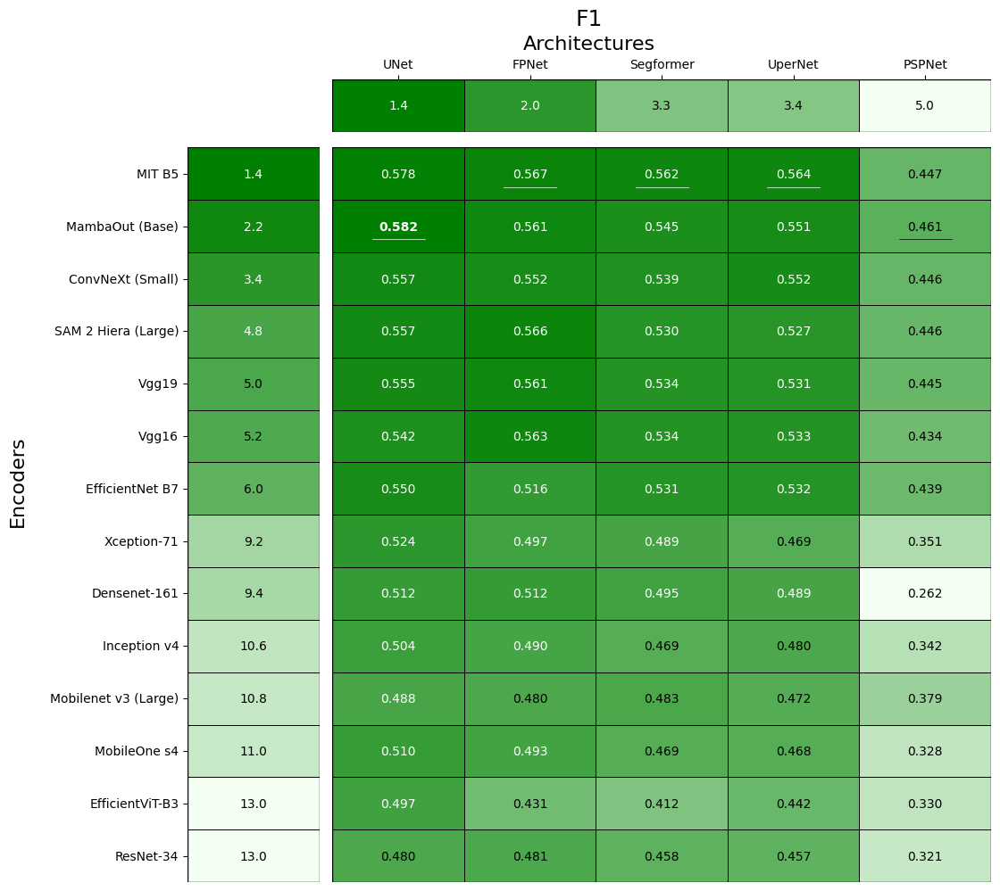

In [41]:
plot_three_heatmaps(df_f1, enc_rankF1, arc_rankF1,"F1",gap_v=0.3, gap_h=0.1,
                    light_val=0.95, dark_val=0.5,central_map=0,
                    arch_label="Architectures", arch_label_pos="top",
                    enc_label="Encoders", enc_label_pos="left")



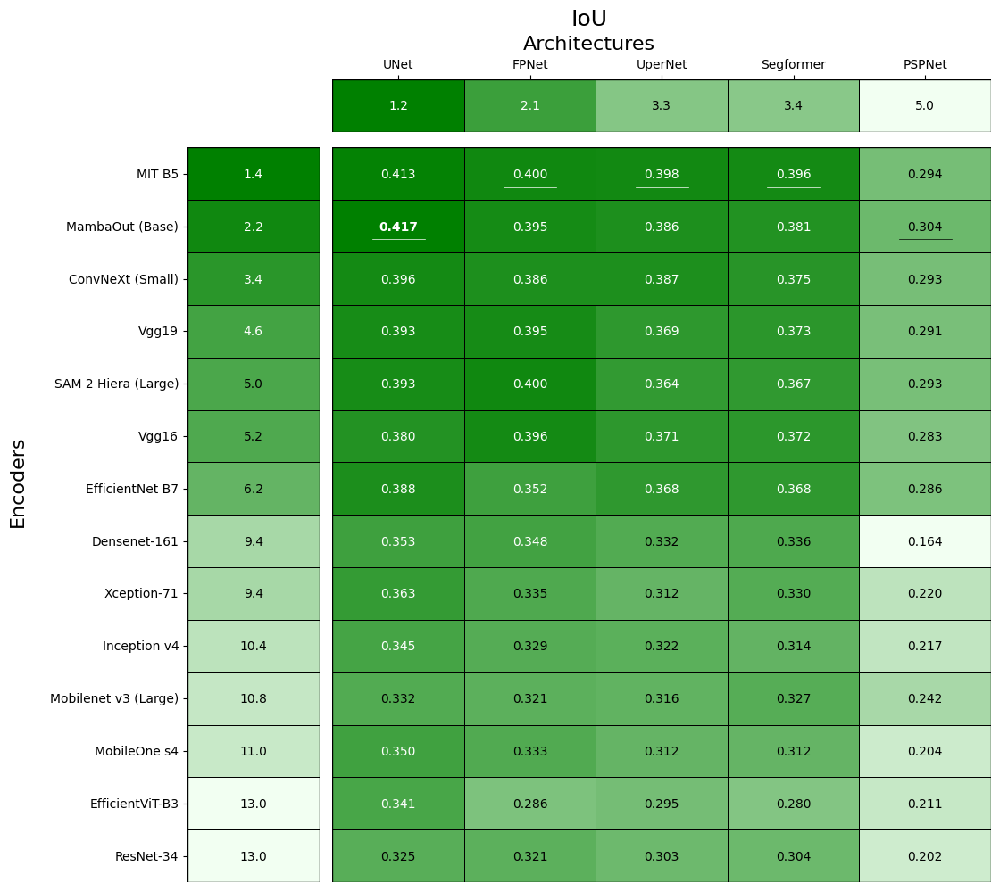

In [ ]:
plot_three_heatmaps(df_IoU, enc_rankIoU, arc_rankIoU,"IoU",gap_v=0.3, gap_h=0.1,
                    light_val=0.95, dark_val=0.5,central_map=0,
                    arch_label="Architectures", arch_label_pos="top",
                    enc_label="Encoders", enc_label_pos="left")

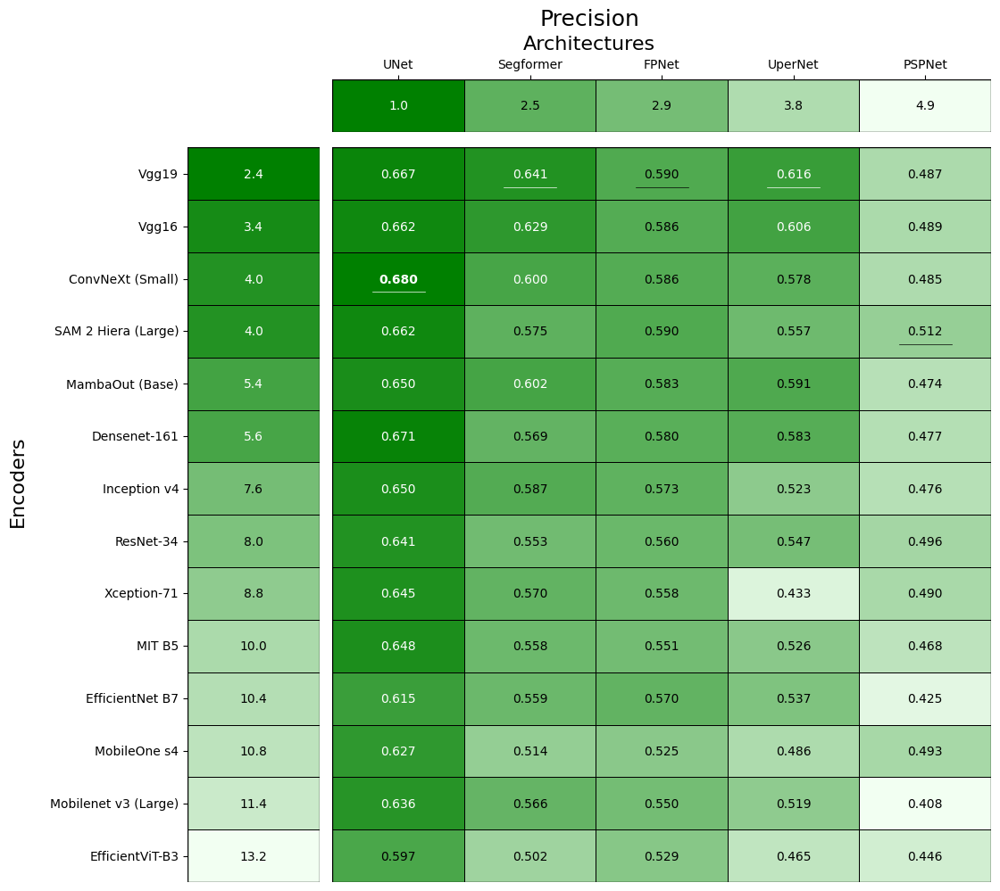

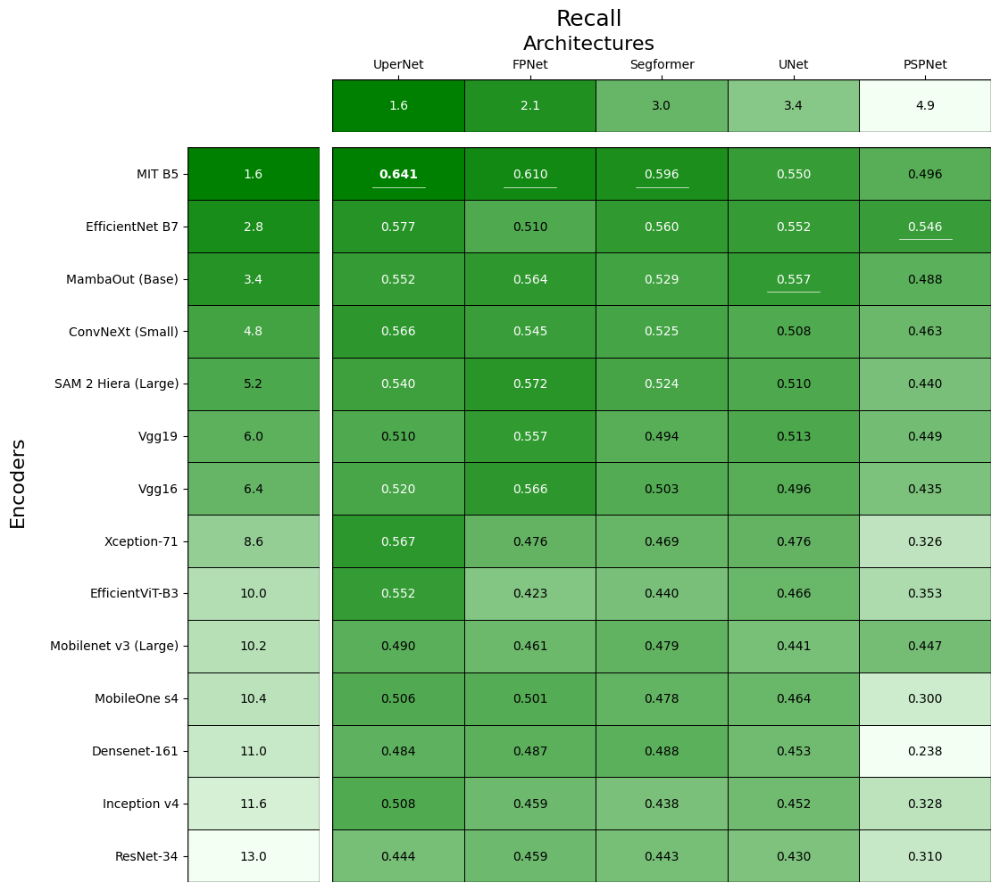

In [ ]:
plot_three_heatmaps(df_pre, enc_rankPre, arc_rankPre,"Precision",gap_v=0.3, gap_h=0.1,
                     light_val=0.95, dark_val=0.5,central_map=0,
                    arch_label="Architectures", arch_label_pos="top",
                    enc_label="Encoders", enc_label_pos="left")
plot_three_heatmaps(df_rec, enc_rankRec, arc_rankRec,"Recall",gap_v=0.3, gap_h=0.1,
                     light_val=0.95, dark_val=0.5,central_map=0,
                    arch_label="Architectures", arch_label_pos="top",
                    enc_label="Encoders", enc_label_pos="left")

## Bayesian tests

In [43]:
#!pip install baycomp

In [44]:
best_IoU = ["fpn_mit_b5","upernet_mit_b5","segformer_mit_b5",
              "unet_tu-mambaout_base_wide_rw","pspnet_tu-mambaout_base_wide_rw"]

best_IoU_readable =["FPNet MIT B5","UperNet MIT B5","Segformer MIT B5",
                      "UNet\nMambaOut","PSPNet\nMambaOut"]



def get_scores(df,name,metric,average_per_fold=False):
  if average_per_fold:
    return df[df["Name"]==name][[metric,"Fold"]].groupby("Fold").mean().values.flatten()
  else:
    return df[df["Name"]==name][metric].values.flatten()


best_IoU_results = []
for name,namel in zip(best_IoU,best_IoU_readable):
  best_IoU_results.append((namel, get_scores(df_raw_results,name,"IoU",True)))



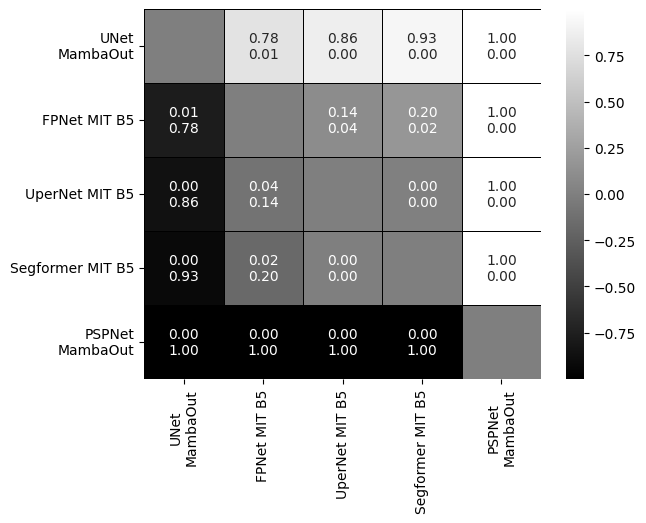

In [52]:
from baycomp import two_on_single
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

def show_bay_test(best_results):
  labels = []
  colors = []

  best_results = sorted(best_results, key=lambda x: np.mean(x[1]), reverse=True)
  best_names = [name for name, _ in best_results]


  for i, (namei,resultsi) in enumerate(best_results):
    labelsi, colorsi  = [], []
    for j, (namej,resultsj) in enumerate(best_results):
      pl, p_rope, pr = two_on_single(resultsi, resultsj, rope=0.01)
      if i==j:
        labelsi.append(f"")
        colorsi.append(0)
      else:
        labelsi.append(f"{pl:.2f}\n{pr:.2f}")
        colorsi.append(pl-pr)
    labels.append(labelsi)
    colors.append(colorsi)

  df_colors = pd.DataFrame(colors,index=best_names,columns=best_names)
  df_labels = pd.DataFrame(labels,index=best_names,columns=best_names)

  # Assuming df_numeros is the dataframe with the numerical values
  # and df_etiquetas is the dataframe with the labels (text)
  sns.heatmap(df_colors, annot=df_labels, fmt='', cmap='grey',linewidths=0.5, linecolor='black')

  plt.show()
  return df_colors, df_labels


df_colors_iou, df_labels_iou = show_bay_test(best_IoU_results)


In [47]:
df_colors_iou.iat[0,0], df_colors_iou.iat[1,1], df_colors_iou.iat[2,2] = 0,0,0
df_colors_iou.iat[3,3], df_colors_iou.iat[4,4] = 0,0

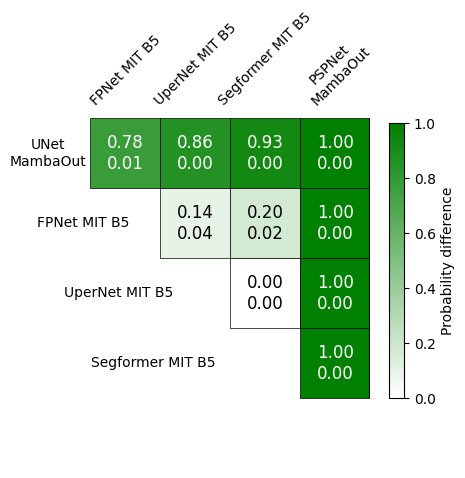

In [53]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import matplotlib.patches as patches
from matplotlib.colors import LinearSegmentedColormap, Normalize

def plot_upper_triangle_compact_grey_with_top_labels_and_save(df_values, df_labels,
                                                              dynamic_text=1,
                                                              ini=0, end=0.5,
                                                              name="heatmap.pdf"):
    """
    Draws a compact heatmap showing only the upper triangle (cells with j > i) of a symmetric matrix,
    with staggered labels on the left and top labels (starting from the second column) above the
    first visible cell.

    Cell colors are determined from df_values using a colormap defined by 'ini' and 'end' parameters,
    which must be between 0 and 1:
      - If ini ≤ end, values are mapped from dark gray (ini) to light gray (end).
      - If ini > end, the mapping is inverted (low values shown light, high values dark).

    Normalization is set from 0 to 1 (originally -1 to 1, corrected based on norm definition).

    Each cell displays the corresponding text from df_labels in the center; if dynamic_text==1,
    the text color adjusts based on the background (white on dark, black on light), otherwise it's always black.

    Additionally, it adds:
      - Staggered labels on the left side for each row (from row 1 onwards), using the
        label of column (i-1) shifted one cell up and to the left.
      - Top labels for all visible columns starting from the second, placed above the first
        visible cell and rotated 45°.

    Finally, the figure is saved as a PDF with the name specified in the 'name' parameter.

    Parameters:
      - df_values: Square DataFrame (n×n) with numerical values (expected range [0,1] based on norm).
      - df_labels: DataFrame of the same shape containing the text to display in each cell.
      - dynamic_text: If 1 (default), adjusts text color based on background; if 0, always black.
      - ini: Value (between 0 and 1) defining the minimum gray intensity for the original gray cmap.
             For the green cmap, defines the green intensity for the end of the range.
      - end: Value (between 0 and 1) defining the maximum gray intensity for the original gray cmap.
             For the green cmap, defines the green intensity for the start of the range.
      - name: Name of the PDF file where the figure is saved.
    """
    # Check dimensions
    if df_values.shape != df_labels.shape:
        raise ValueError("df_values and df_labels shold have the same shape")
    n, m = df_values.shape
    if n != m:
        raise ValueError("The matrix shold be squared")

    # Define the colomap using ini and end values.
    ''' # grey
    if ini <= end:
        cmap = LinearSegmentedColormap.from_list("custom_cmap", [(ini, ini, ini), (end, end, end)], N=256)
    else:
        cmap = LinearSegmentedColormap.from_list("custom_cmap", [(end, end, end), (ini, ini, ini)], N=256)
    '''

    # green
    if ini <= end:
      cmap = LinearSegmentedColormap.from_list("custom_cmap", [(1, 1, 1), (0, end, 0)], N=256)
    else:
      cmap = LinearSegmentedColormap.from_list("custom_cmap", [(0, end, 0), (0, ini, 0)], N=256)



    norm = Normalize(vmin=0, vmax=1)

    # Get column labels (if they exist) or use indices.
    col_labels = list(df_values.columns) if hasattr(df_values, "columns") else [str(i) for i in range(n)]

    fig, ax = plt.subplots(figsize=(n, n))

    # Draw the cells: for each row i, draw cells for columns j where j > i.
    for i in range(n):
        for j in range(i+1, n):
            x = j
            y = i
            value = df_values.iloc[i, j]
            cell_color = cmap(norm(value))
            rect = patches.Rectangle((x, y), 1, 1, facecolor=cell_color,
                                     edgecolor='black', lw=0.5)
            ax.add_patch(rect)
            label = str(df_labels.iloc[i, j])
            if dynamic_text:
                r, g, b, _ = cell_color
                luminance = 0.299*r + 0.587*g + 0.114*b
                txt_color = "white" if luminance < 0.5 else "black"
            else:
                txt_color = "black"
            # Place the text in the center of the cell.
            ax.text(x + 0.5, y + 0.5, label, ha='center', va='center',
                    color=txt_color, fontsize=12)

    # Draw staggered labels on the left side (for rows 1 to n-1).
    # Use the label of column (i-1), centered in the gap of width (i+1) and shifted:
    # original center position: ( (i+1)/2, i+0.5 ); shifted one cell left and up.
    for i in range(1, n):
        gap_width = i + 1
        x_gap = (gap_width / 2.0) - 0.6  # shifted 1 cell to the left
        y_gap = (i + 0.5) - 1          # shifted 1 cell upwards
        label_gap = col_labels[i-1] if (i-1) < len(col_labels) else ""
        ax.text(x_gap, y_gap, label_gap, ha='center', va='center',
                color="black", fontsize=10)

    # Draw top labels: for each visible column (from column 1 onwards),
    # place the label above the first visible cell.
    for j in range(1, n):
        x_top = j + 0.5
        y_top = -0.15  # vertical position adjusted to be close to the triangle
        label_top = col_labels[j]
        ax.text(x_top, y_top, label_top, ha='center', va='bottom',
                color="black", fontsize=10, rotation=45)

    # Adjust axis limits and appearance.
    ax.set_xlim(0, n)
    ax.set_ylim(-0.5, n)
    ax.set_aspect('equal')
    ax.invert_yaxis()  # Row 0 stays at the top.
    ax.set_xticks([])
    ax.set_yticks([])
    # Remove the outer borders (spines) of the axis.
    for spine in ax.spines.values():
        spine.set_visible(False)


    ax.axvline(x=len(df_values), color='black', linewidth=1.5, ymin=0.185, ymax=0.905)


    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])

    cax = fig.add_axes([0.9, 0.25, 0.03, 0.55])  # [left, bottom, width, height]

    cbar = fig.colorbar(sm, cax=cax, orientation='vertical', pad=0.02)
    cbar.set_label("Probability difference", fontsize=10)

    # Save as PDF.
    fig.savefig(name, format="pdf", bbox_inches="tight")
    plt.show()


plot_upper_triangle_compact_grey_with_top_labels_and_save(df_colors_iou, df_labels_iou, dynamic_text=1,
                                                          ini=0, end=0.5, name="heatmap_iou_verde.pdf")

In [1]:
!pip install --upgrade nbconvert

